In [5]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os
import glob

import phase1_preprocessor

# --- CONFIGURATION ---
# Dataset root (must contain category folders like 'Gravity Falls')
DATASET_ROOT = "Jigsaw Puzzle Dataset/Gravity Falls"

# Ground Truth images (the 'correct' folder)
GROUND_TRUTH_DIR = os.path.join(DATASET_ROOT, "correct")

# Where Phase 2 solver saved solutions
SOLVER_OUTPUT_DIR = "phase 2 solutions"

# Where Phase 1 saved the pieces
PHASE1_OUTPUT_DIR = "phase 1 processed"

# Display Settings
plt.rcParams['figure.figsize'] = [15, 10]

def load_rgb(path):
    """Helper to load image in RGB for Matplotlib. Returns None if missing."""
    if not path or not os.path.exists(path):
        return None
    img = cv2.imread(path)
    if img is None:
        return None
    return cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

def find_ground_truth_path(puzzle_id):
    """Find ground-truth file for a puzzle id (supports png/jpg/jpeg)."""
    for ext in (".png", ".jpg", ".jpeg"):
        p = os.path.join(GROUND_TRUTH_DIR, f"{puzzle_id}{ext}")
        if os.path.exists(p):
            return p
    # fallback: recursive search under dataset root
    pattern = os.path.join(DATASET_ROOT, "**", "correct", f"{puzzle_id}.*")
    cands = glob.glob(pattern, recursive=True)
    return cands[0] if cands else None

def find_processed_puzzle_folder(puzzle_id, grid_size=None):
    """Find Phase 1 output folder for a puzzle id (optionally scoped to a grid size)."""
    if grid_size is not None:
        folder_type = f"puzzle_{grid_size}x{grid_size}"
        pattern = os.path.join(PHASE1_OUTPUT_DIR, "**", folder_type, f"puzzle_{puzzle_id}")
    else:
        pattern = os.path.join(PHASE1_OUTPUT_DIR, "**", f"puzzle_{puzzle_id}")
    cands = sorted(glob.glob(pattern, recursive=True))
    return cands[0] if cands else None

print("Setup Complete. Ready to validate.")
print(f"GROUND_TRUTH_DIR: {GROUND_TRUTH_DIR}")
print(f"SOLVER_OUTPUT_DIR: {SOLVER_OUTPUT_DIR}")
print(f"PHASE1_OUTPUT_DIR: {PHASE1_OUTPUT_DIR}")

Setup Complete. Ready to validate.
GROUND_TRUTH_DIR: Jigsaw Puzzle Dataset/Gravity Falls\correct
SOLVER_OUTPUT_DIR: phase 2 solutions
PHASE1_OUTPUT_DIR: phase 1 processed


=== 2x2 Puzzles ===


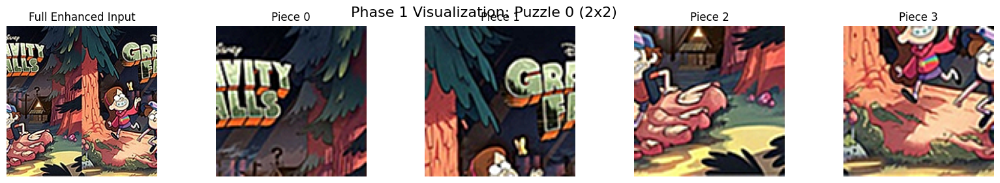

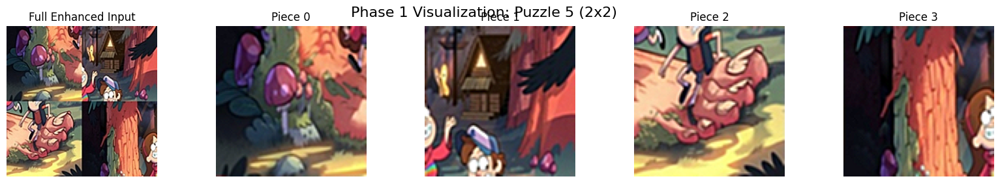

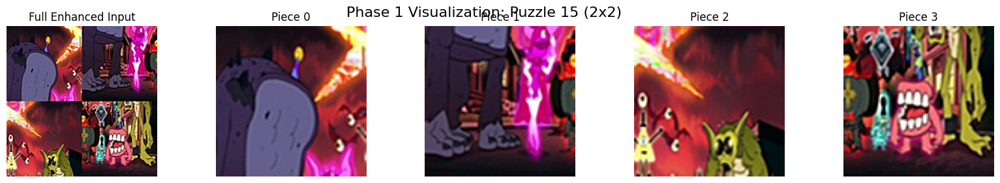

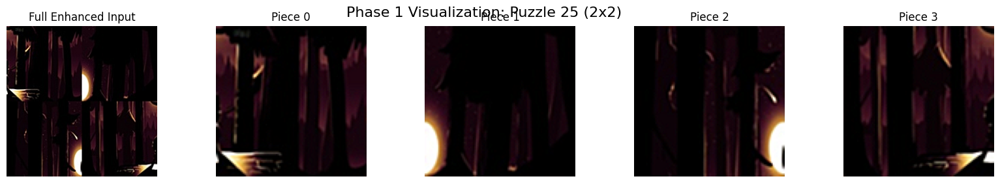

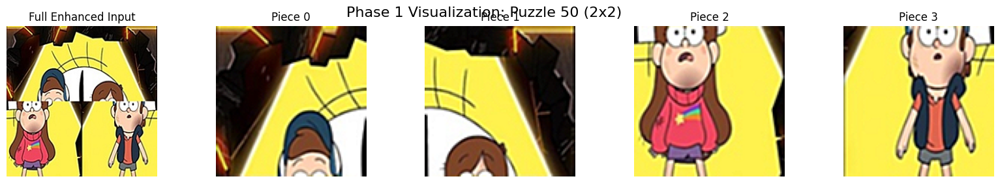

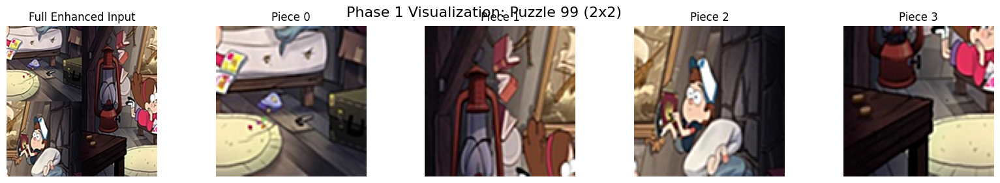


=== 4x4 Puzzles ===


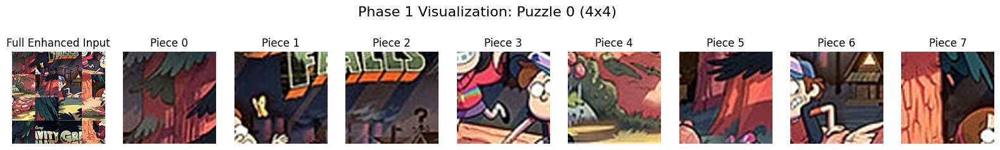

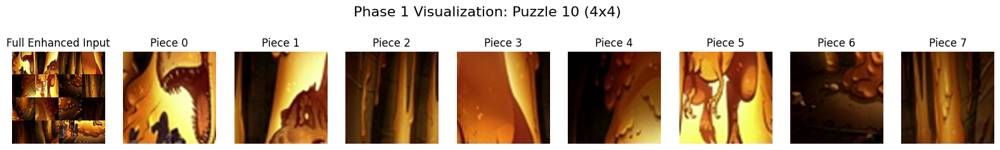

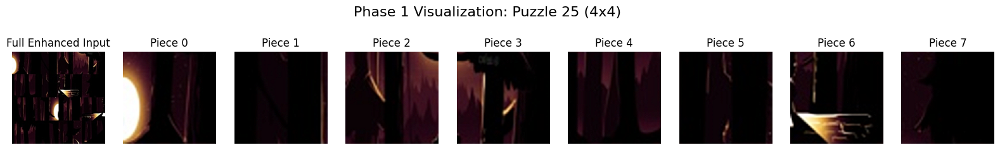

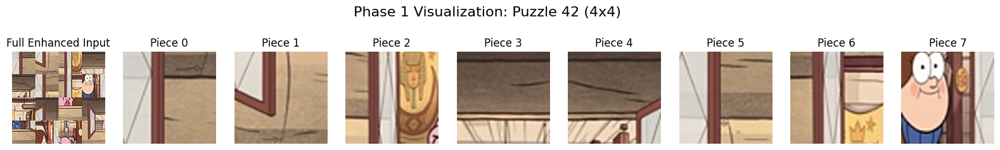

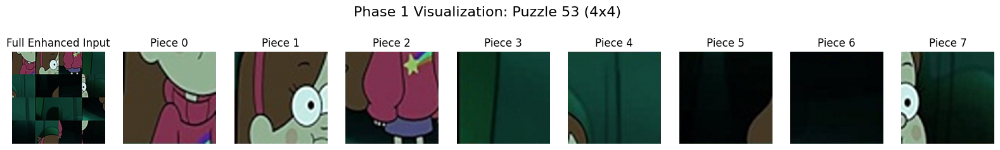

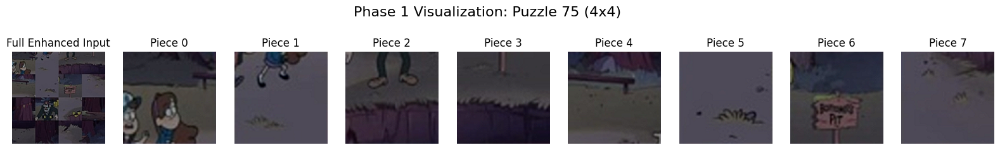


=== 8x8 Puzzles ===


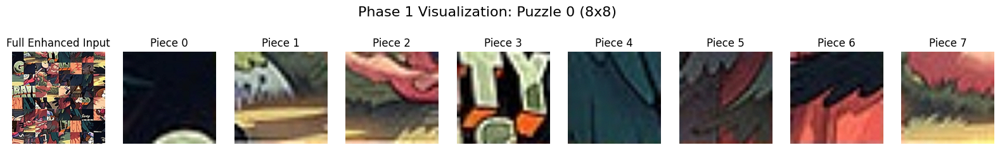

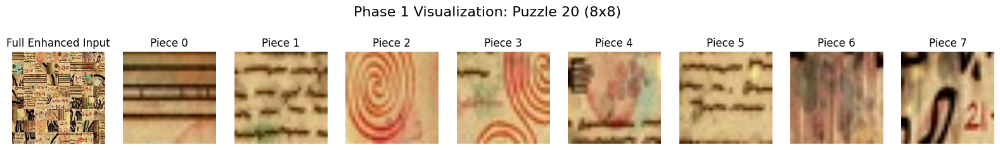

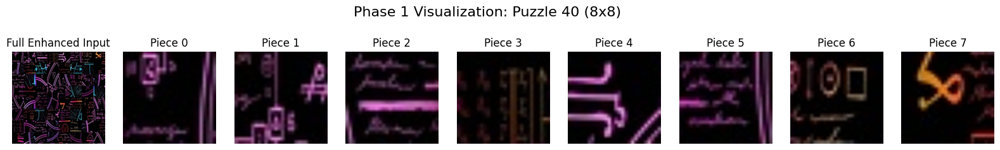

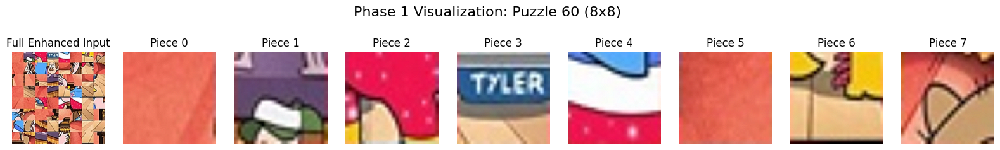

In [6]:
def visualize_phase_1(puzzle_name, grid_size=8):
    """
    Visualizes the raw input vs the extracted/enhanced pieces.
    puzzle_name:  "0" or "5"
    grid_size:  4 or 8
    """
    # Locate Phase 1 output folder for this puzzle & grid size
    target_folder = find_processed_puzzle_folder(puzzle_name, grid_size=grid_size)
    if not target_folder:
        print(f"Could not find Phase 1 output for puzzle_{puzzle_name} ({grid_size}x{grid_size})")
        return

    # Load Full Enhanced Reference
    full_ref_path = os.path.join(target_folder, f"{puzzle_name}_enhanced.jpg")
    full_img = load_rgb(full_ref_path)

    # Load up to Pieces
    pieces = []
    for i in range(grid_size * grid_size):
        p_path = os.path.join(target_folder, f"piece_{i:03d}.png")
        pieces.append(load_rgb(p_path))

    # Plot
    fig, axes = plt.subplots(1, min(9, grid_size * grid_size + 1), figsize=(20, 3))

    # Show Full Reference
    if full_img is not None:
        axes[0].imshow(full_img)
        axes[0].set_title("Full Enhanced Input")
    else:
        axes[0].text(0.5, 0.5, "Ref Not Found", ha='center')
    axes[0].axis('off')

    # Show Individual Pieces (up to 8)
    for i, p_img in enumerate(pieces[:8]):
        if p_img is not None:
            axes[i+1].imshow(p_img)
            axes[i+1].set_title(f"Piece {i}")
            axes[i+1].axis('off')
            # Add a border to show they are separate assets
            for spine in axes[i+1].spines.values():
                spine.set_edgecolor('red')
                spine.set_linewidth(2)
        else:
            axes[i+1].axis('off')

    plt.suptitle(f"Phase 1 Visualization: Puzzle {puzzle_name} ({grid_size}x{grid_size})", fontsize=16)
    plt.show()

# Run Demo - 2x2 puzzles
print("=== 2x2 Puzzles ===")
visualize_phase_1(puzzle_name="0", grid_size=2)
visualize_phase_1(puzzle_name="5", grid_size=2)
visualize_phase_1(puzzle_name="15", grid_size=2)
visualize_phase_1(puzzle_name="25", grid_size=2)
visualize_phase_1(puzzle_name="50", grid_size=2)
visualize_phase_1(puzzle_name="99", grid_size=2)

# Run Demo - 4x4 puzzles
print("\n=== 4x4 Puzzles ===")
visualize_phase_1(puzzle_name="0", grid_size=4)
visualize_phase_1(puzzle_name="10", grid_size=4)
visualize_phase_1(puzzle_name="25", grid_size=4)
visualize_phase_1(puzzle_name="42", grid_size=4)
visualize_phase_1(puzzle_name="53", grid_size=4)
visualize_phase_1(puzzle_name="75", grid_size=4)

# Run Demo - 8x8 puzzles
print("\n=== 8x8 Puzzles ===")
visualize_phase_1(puzzle_name="0", grid_size=8)
visualize_phase_1(puzzle_name="20", grid_size=8)
visualize_phase_1(puzzle_name="40", grid_size=8)
visualize_phase_1(puzzle_name="60", grid_size=8)

--- VALIDATION: Sampling 20 per Category ---


==================== CATEGORY: puzzle_2x2 (110 found) ====================
Puzzle 78: Pixel=100.0% | SSIM=95.3% | PSNR=34.0dB | MSE=26.0
Puzzle 105: Pixel=19.5% | SSIM=18.1% | PSNR=10.0dB | MSE=6559.2
Puzzle 64: Pixel=99.9% | SSIM=95.5% | PSNR=30.9dB | MSE=53.2
Puzzle 2: Pixel=100.0% | SSIM=91.5% | PSNR=30.9dB | MSE=53.2
Puzzle 66: Pixel=99.9% | SSIM=96.3% | PSNR=35.2dB | MSE=19.7
Puzzle 16: Pixel=100.0% | SSIM=93.6% | PSNR=32.3dB | MSE=38.3
Puzzle 0: Pixel=98.9% | SSIM=93.7% | PSNR=27.5dB | MSE=116.5
Puzzle 67: Pixel=100.0% | SSIM=91.5% | PSNR=30.0dB | MSE=64.7
Puzzle 106: Pixel=99.5% | SSIM=94.7% | PSNR=27.6dB | MSE=112.9
Puzzle 86: Pixel=100.0% | SSIM=96.1% | PSNR=33.6dB | MSE=28.2
Puzzle 80: Pixel=99.9% | SSIM=96.7% | PSNR=31.3dB | MSE=47.9
Puzzle 20: Pixel=99.7% | SSIM=95.9% | PSNR=29.7dB | MSE=69.3
Puzzle 4: Pixel=99.9% | SSIM=93.5% | PSNR=31.8dB | MSE=43.1
Puzzle 15: Pixel=99.0% | SSIM=90.8% | PSNR=27.2dB | MSE=122.8
Puzzle 61: Pixe

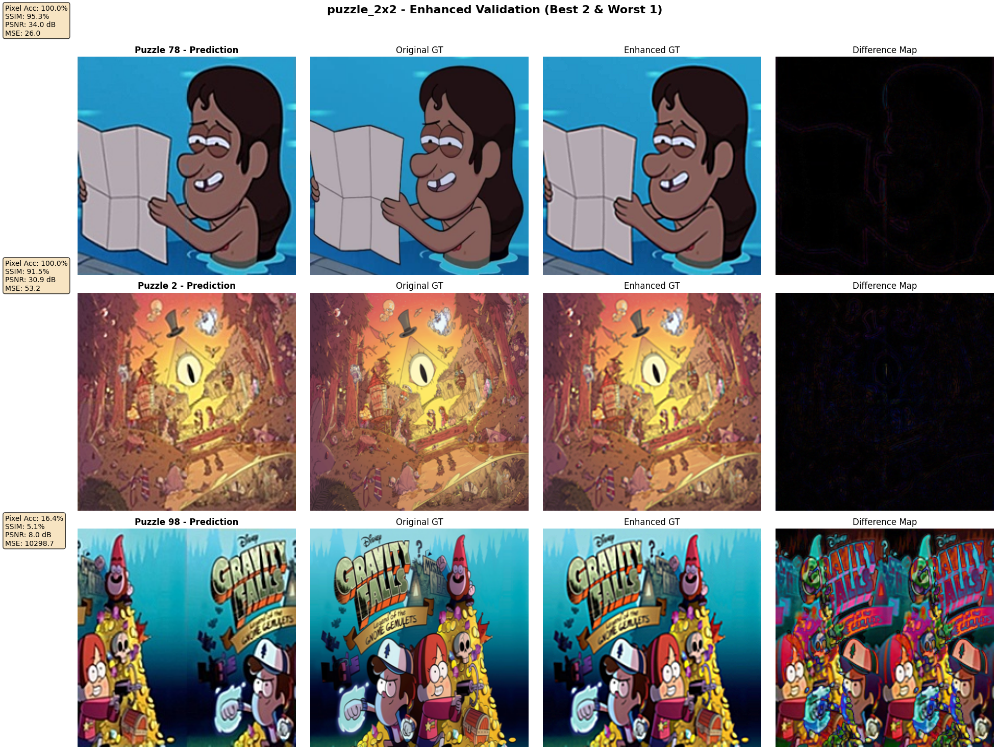



==================== CATEGORY: puzzle_4x4 (110 found) ====================
Puzzle 47: Pixel=99.2% | SSIM=91.5% | PSNR=30.2dB | MSE=62.0
Puzzle 109: Pixel=98.3% | SSIM=89.7% | PSNR=26.7dB | MSE=137.8
Puzzle 28: Pixel=21.8% | SSIM=11.3% | PSNR=8.2dB | MSE=9799.6
Puzzle 41: Pixel=49.0% | SSIM=25.2% | PSNR=12.5dB | MSE=3694.5
Puzzle 100: Pixel=98.8% | SSIM=90.9% | PSNR=28.0dB | MSE=103.6
Puzzle 66: Pixel=99.3% | SSIM=93.3% | PSNR=30.3dB | MSE=61.4
Puzzle 56: Pixel=98.9% | SSIM=93.3% | PSNR=28.6dB | MSE=90.0
Puzzle 81: Pixel=98.8% | SSIM=92.5% | PSNR=29.0dB | MSE=81.1
Puzzle 80: Pixel=98.3% | SSIM=92.4% | PSNR=26.7dB | MSE=138.0
Puzzle 73: Pixel=99.2% | SSIM=91.0% | PSNR=30.4dB | MSE=59.7
Puzzle 51: Pixel=88.3% | SSIM=81.1% | PSNR=19.1dB | MSE=793.0
Puzzle 98: Pixel=97.7% | SSIM=86.0% | PSNR=25.2dB | MSE=196.9
Puzzle 90: Pixel=98.7% | SSIM=93.1% | PSNR=28.4dB | MSE=93.8
Puzzle 50: Pixel=98.7% | SSIM=90.9% | PSNR=27.5dB | MSE=115.0
Puzzle 60: Pixel=98.5% | SSIM=90.2% | PSNR=27.4dB | MSE=11

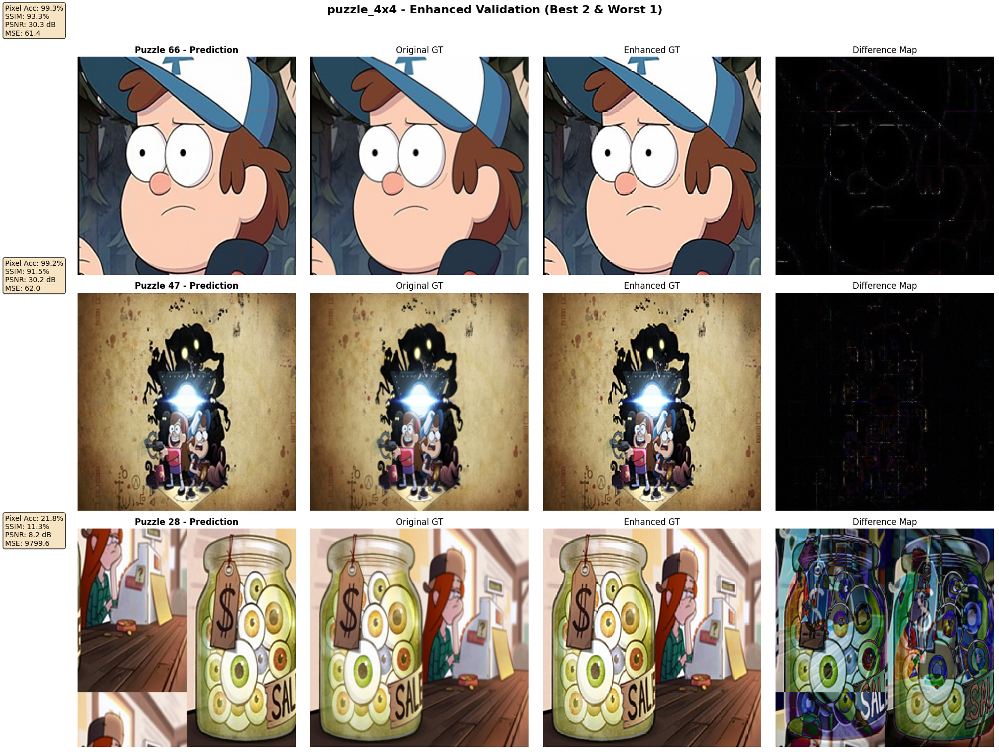



==================== CATEGORY: puzzle_8x8 (110 found) ====================
Puzzle 5: Pixel=22.4% | SSIM=21.9% | PSNR=9.0dB | MSE=8125.7
Puzzle 96: Pixel=19.9% | SSIM=17.2% | PSNR=8.7dB | MSE=8812.5
Puzzle 93: Pixel=28.6% | SSIM=17.0% | PSNR=7.2dB | MSE=12504.8
Puzzle 35: Pixel=84.3% | SSIM=76.0% | PSNR=16.2dB | MSE=1568.3
Puzzle 71: Pixel=28.8% | SSIM=25.2% | PSNR=9.6dB | MSE=7182.4
Puzzle 61: Pixel=18.3% | SSIM=20.8% | PSNR=7.7dB | MSE=11170.4
Puzzle 63: Pixel=19.5% | SSIM=21.1% | PSNR=7.2dB | MSE=12372.3
Puzzle 40: Pixel=67.1% | SSIM=19.1% | PSNR=13.7dB | MSE=2766.6
Puzzle 2: Pixel=93.0% | SSIM=72.5% | PSNR=23.4dB | MSE=298.1
Puzzle 19: Pixel=46.9% | SSIM=25.4% | PSNR=10.0dB | MSE=6439.3
Puzzle 13: Pixel=30.6% | SSIM=25.3% | PSNR=10.2dB | MSE=6167.4
Puzzle 38: Pixel=73.0% | SSIM=79.3% | PSNR=16.7dB | MSE=1381.6
Puzzle 57: Pixel=48.3% | SSIM=35.3% | PSNR=10.8dB | MSE=5367.8
Puzzle 23: Pixel=30.9% | SSIM=31.8% | PSNR=8.9dB | MSE=8297.1
Puzzle 22: Pixel=37.9% | SSIM=29.0% | PSNR=10.3d

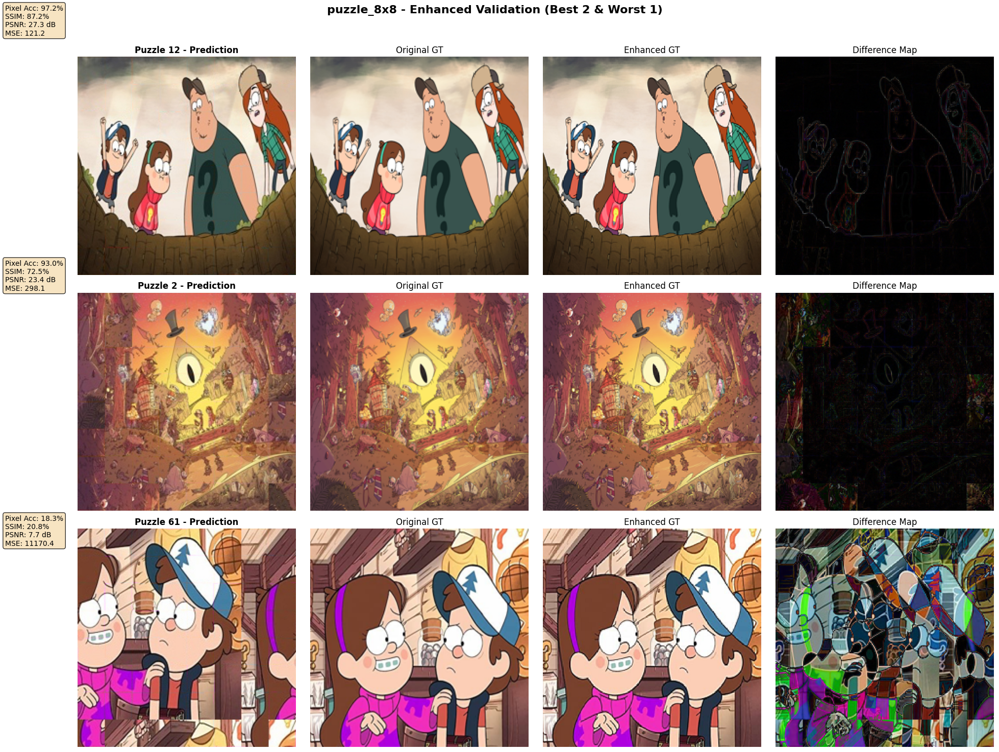

In [7]:
import random
from skimage.metrics import structural_similarity as ssim
from skimage.metrics import peak_signal_noise_ratio as psnr

SAMPLE_SIZE = 20  # Number of puzzles to validate per category

def enhance_ground_truth(image_rgb):
    """
    Applies Phase 1 enhancement pipeline to Ground Truth for fair comparison.
    Phase 1 enhancement expects BGR (cv2.imread output), so we convert.
    """
    if image_rgb is None:
        return None
    image_bgr = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2BGR)
    enhanced_bgr = phase1_preprocessor.enhance_image(image_bgr)
    return cv2.cvtColor(enhanced_bgr, cv2.COLOR_BGR2RGB)

def calculate_metrics(pred_img, gt_img):
    """
    Calculate multiple accuracy metrics between prediction and ground truth.
    Returns: dict with pixel_accuracy, ssim_score, psnr_score, mse
    """
    if pred_img is None or gt_img is None:
        return None
    
    h, w, _ = pred_img.shape

    # 1. Resize GT to match prediction
    gt_resized = cv2.resize(gt_img, (w, h), interpolation=cv2.INTER_AREA)

    # 2. Enhance GT using Phase 1 enhancer
    gt_final = enhance_ground_truth(gt_resized)

    # 3. Calculate multiple metrics
    metrics = {}
    
    # Pixel Accuracy (threshold-based)
    diff = cv2.absdiff(pred_img, gt_final)
    gray_diff = cv2.cvtColor(diff, cv2.COLOR_RGB2GRAY)
    correct_pixels = np.sum(gray_diff < 30)
    metrics['pixel_accuracy'] = (correct_pixels / gray_diff.size) * 100
    
    # SSIM (Structural Similarity Index)
    try:
        metrics['ssim'] = ssim(gt_final, pred_img, multichannel=True, channel_axis=2, data_range=255) * 100
    except:
        metrics['ssim'] = 0.0
    
    # PSNR (Peak Signal-to-Noise Ratio)
    try:
        metrics['psnr'] = psnr(gt_final, pred_img, data_range=255)
    except:
        metrics['psnr'] = 0.0
    
    # MSE (Mean Squared Error)
    metrics['mse'] = np.mean((pred_img.astype(float) - gt_final.astype(float)) ** 2)
    
    # Color difference
    return metrics, gt_final

def validate_and_visualize():
    print(f"--- VALIDATION: Sampling {SAMPLE_SIZE} per Category ---")

    # 1. Find all solutions in the new structure (category folders with numbered files)
    categories = {"puzzle_2x2": [], "puzzle_4x4": [], "puzzle_8x8": []}
    
    for cat_name in categories.keys():
        cat_path = os.path.join(SOLVER_OUTPUT_DIR, cat_name)
        if os.path.exists(cat_path):
            # Find all .jpg files in this category folder
            solutions = glob.glob(os.path.join(cat_path, "*.jpg"))
            categories[cat_name] = solutions

    # 2. Process each category
    for cat_name, files in categories.items():
        if not files:
            continue

        print(f"\n\n{'='*20} CATEGORY: {cat_name} ({len(files)} found) {'='*20}")

        # Random Sample
        sample_files = random.sample(files, min(len(files), SAMPLE_SIZE))
        results = []

        for sol_path in sample_files:
            # Extract puzzle ID from filename (e.g., "0.jpg" -> "0")
            file_name = os.path.basename(sol_path)
            puzzle_id = os.path.splitext(file_name)[0]  # Remove extension
            
            if not puzzle_id:
                continue

            pred_img = load_rgb(sol_path)
            if pred_img is None:
                print(f"Puzzle {puzzle_id}: Solution not loaded")
                continue

            gt_path = find_ground_truth_path(puzzle_id)
            gt_img = load_rgb(gt_path) if gt_path else None

            if gt_img is None:
                print(f"Puzzle {puzzle_id}: GT Not Found")
                continue

            metrics_result = calculate_metrics(pred_img, gt_img)
            if metrics_result is None:
                continue
                
            metrics, gt_enhanced = metrics_result
            results.append((puzzle_id, metrics, pred_img, gt_img, gt_enhanced))
            print(f"Puzzle {puzzle_id}: Pixel={metrics['pixel_accuracy']:.1f}% | SSIM={metrics['ssim']:.1f}% | PSNR={metrics['psnr']:.1f}dB | MSE={metrics['mse']:.1f}")

        # 3. Calculate category statistics
        if results:
            all_pixel_acc = [r[1]['pixel_accuracy'] for r in results]
            all_ssim = [r[1]['ssim'] for r in results]
            all_psnr = [r[1]['psnr'] for r in results]
            all_mse = [r[1]['mse'] for r in results]
            
            print(f"\n--- {cat_name} Statistics ---")
            print(f"Pixel Accuracy: Mean={np.mean(all_pixel_acc):.2f}% | Std={np.std(all_pixel_acc):.2f}% | Min={np.min(all_pixel_acc):.2f}% | Max={np.max(all_pixel_acc):.2f}%")
            print(f"SSIM:           Mean={np.mean(all_ssim):.2f}% | Std={np.std(all_ssim):.2f}% | Min={np.min(all_ssim):.2f}% | Max={np.max(all_ssim):.2f}%")
            print(f"PSNR:           Mean={np.mean(all_psnr):.2f}dB | Std={np.std(all_psnr):.2f}dB | Min={np.min(all_psnr):.2f}dB | Max={np.max(all_psnr):.2f}dB")
            print(f"MSE:            Mean={np.mean(all_mse):.2f} | Std={np.std(all_mse):.2f}")

        # 4. Enhanced Visualization
        if results:
            # Show top 2 best and 1 worst from this sample (by pixel accuracy)
            results.sort(key=lambda x: x[1]['pixel_accuracy'], reverse=True)
            to_show = results[:2] + [results[-1]] if len(results) >= 3 else results

            # Create 4-column layout: Prediction, Ground Truth, Enhanced GT, Difference
            fig, axes = plt.subplots(len(to_show), 4, figsize=(20, 5 * len(to_show)))
            if len(to_show) == 1:
                axes = axes.reshape(1, -1)

            for i, (pid, metrics, pred, gt, gt_enh) in enumerate(to_show):
                # Prediction
                axes[i][0].imshow(pred)
                axes[i][0].set_title(f"Puzzle {pid} - Prediction", fontsize=12, fontweight='bold')
                axes[i][0].axis('off')

                # Original Ground Truth
                axes[i][1].imshow(gt)
                axes[i][1].set_title(f"Original GT", fontsize=12)
                axes[i][1].axis('off')

                # Enhanced Ground Truth (what we compare against)
                axes[i][2].imshow(gt_enh)
                axes[i][2].set_title(f"Enhanced GT", fontsize=12)
                axes[i][2].axis('off')

                # Difference Map
                diff_map = cv2.absdiff(pred, gt_enh)
                axes[i][3].imshow(diff_map)
                axes[i][3].set_title(f"Difference Map", fontsize=12)
                axes[i][3].axis('off')

                # Add metrics as text annotation
                metrics_text = (f"Pixel Acc: {metrics['pixel_accuracy']:.1f}%\n"
                               f"SSIM: {metrics['ssim']:.1f}%\n"
                               f"PSNR: {metrics['psnr']:.1f} dB\n"
                               f"MSE: {metrics['mse']:.1f}")
                fig.text(0.02, 0.98 - (i * (1.0 / len(to_show))), metrics_text, 
                        fontsize=10, verticalalignment='top', 
                        bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.8))

            plt.suptitle(f"{cat_name} - Enhanced Validation (Best 2 & Worst 1)", fontsize=16, fontweight='bold')
            plt.tight_layout(rect=[0.08, 0, 1, 0.96])
            plt.show()

# Run
validate_and_visualize()

COMPREHENSIVE ACCURACY ANALYSIS - ALL SOLUTIONS

--------------------------------------------------------------------------------
Processing puzzle_2x2: 110 puzzles
--------------------------------------------------------------------------------

puzzle_2x2 Results: 110 successful, 0 failed

  Pixel Accuracy:
    Mean:    94.82%
    Median:  99.88%
    Std:     17.90%
    Min:     16.43%
    Max:    100.00%

  SSIM Score:
    Mean:    88.93%
    Median:  95.21%
    Std:     21.69%
    Min:      5.10%
    Max:     98.45%

  PSNR:
    Mean:    30.28 dB
    Median:  31.69 dB
    Std:      6.26 dB
    Min:      8.00 dB
    Max:     39.31 dB

  MSE:
    Mean:   555.51
    Median:  44.07
    Std:    1848.61

--------------------------------------------------------------------------------
Processing puzzle_4x4: 110 puzzles
--------------------------------------------------------------------------------

puzzle_4x4 Results: 110 successful, 0 failed

  Pixel Accuracy:
    Mean:    85.73%
    Me

C:\Users\bobah\AppData\Local\Temp\ipykernel_6024\3091380208.py:177: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  axes[1, 0].boxplot(cat_data_pixel, labels=cat_labels)
C:\Users\bobah\AppData\Local\Temp\ipykernel_6024\3091380208.py:190: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  axes[1, 1].boxplot(cat_data_ssim, labels=cat_labels)


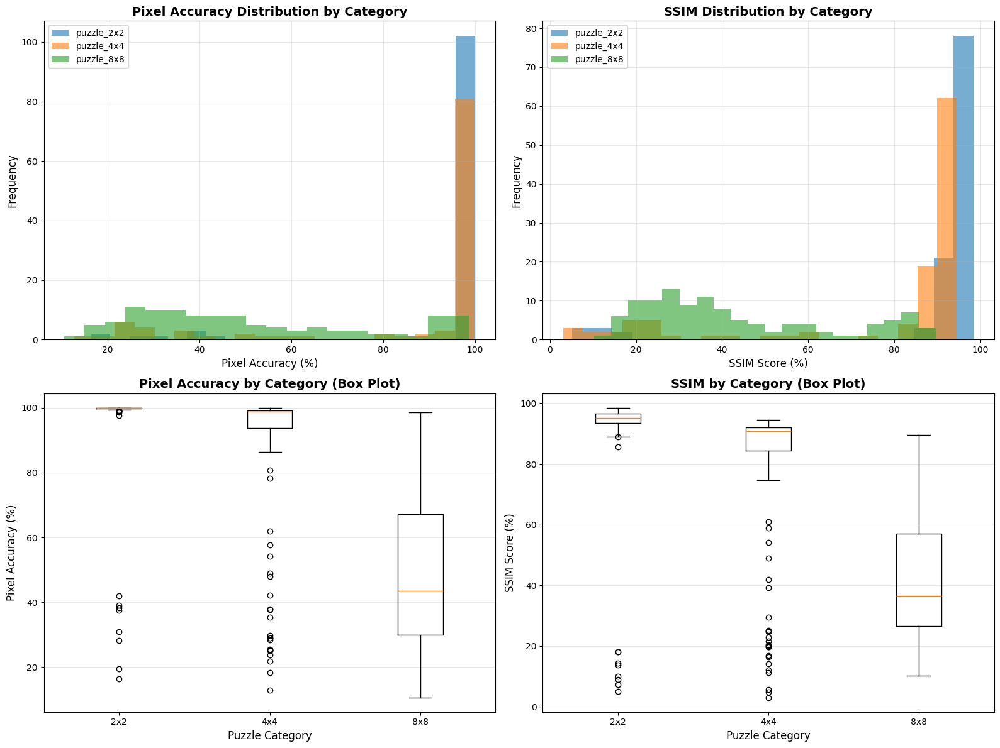

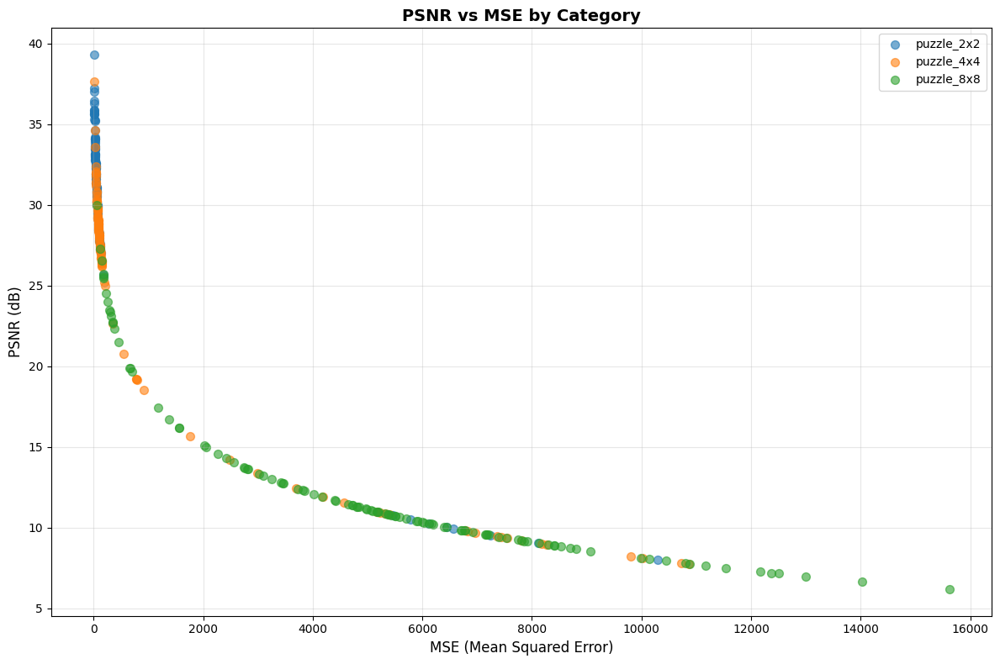

In [8]:
def comprehensive_accuracy_analysis():
    """
    Iterate over ALL solutions (not just samples) and compute comprehensive statistics.
    """
    print("="*80)
    print("COMPREHENSIVE ACCURACY ANALYSIS - ALL SOLUTIONS")
    print("="*80)
    
    # Find all solutions
    categories = {"puzzle_2x2": [], "puzzle_4x4": [], "puzzle_8x8": []}
    
    for cat_name in categories.keys():
        cat_path = os.path.join(SOLVER_OUTPUT_DIR, cat_name)
        if os.path.exists(cat_path):
            solutions = glob.glob(os.path.join(cat_path, "*.jpg"))
            categories[cat_name] = solutions
    
    # Storage for all results
    all_results = {}
    overall_stats = {
        'pixel_accuracy': [],
        'ssim': [],
        'psnr': [],
        'mse': []
    }
    
    # Process each category
    for cat_name, files in categories.items():
        if not files:
            print(f"\n{cat_name}: No solutions found")
            continue
            
        print(f"\n{'-'*80}")
        print(f"Processing {cat_name}: {len(files)} puzzles")
        print(f"{'-'*80}")
        
        category_results = []
        successful = 0
        failed = 0
        
        for sol_path in files:
            file_name = os.path.basename(sol_path)
            puzzle_id = os.path.splitext(file_name)[0]
            
            if not puzzle_id:
                continue
            
            # Load prediction
            pred_img = load_rgb(sol_path)
            if pred_img is None:
                failed += 1
                continue
            
            # Load ground truth
            gt_path = find_ground_truth_path(puzzle_id)
            gt_img = load_rgb(gt_path) if gt_path else None
            
            if gt_img is None:
                failed += 1
                continue
            
            # Calculate metrics
            metrics_result = calculate_metrics(pred_img, gt_img)
            if metrics_result is None:
                failed += 1
                continue
            
            metrics, _ = metrics_result
            category_results.append({
                'puzzle_id': puzzle_id,
                'metrics': metrics
            })
            
            # Add to overall stats
            overall_stats['pixel_accuracy'].append(metrics['pixel_accuracy'])
            overall_stats['ssim'].append(metrics['ssim'])
            overall_stats['psnr'].append(metrics['psnr'])
            overall_stats['mse'].append(metrics['mse'])
            
            successful += 1
        
        all_results[cat_name] = category_results
        
        # Print category statistics
        if category_results:
            pixel_accs = [r['metrics']['pixel_accuracy'] for r in category_results]
            ssims = [r['metrics']['ssim'] for r in category_results]
            psnrs = [r['metrics']['psnr'] for r in category_results]
            mses = [r['metrics']['mse'] for r in category_results]
            
            print(f"\n{cat_name} Results: {successful} successful, {failed} failed")
            print(f"\n  Pixel Accuracy:")
            print(f"    Mean:   {np.mean(pixel_accs):6.2f}%")
            print(f"    Median: {np.median(pixel_accs):6.2f}%")
            print(f"    Std:    {np.std(pixel_accs):6.2f}%")
            print(f"    Min:    {np.min(pixel_accs):6.2f}%")
            print(f"    Max:    {np.max(pixel_accs):6.2f}%")
            
            print(f"\n  SSIM Score:")
            print(f"    Mean:   {np.mean(ssims):6.2f}%")
            print(f"    Median: {np.median(ssims):6.2f}%")
            print(f"    Std:    {np.std(ssims):6.2f}%")
            print(f"    Min:    {np.min(ssims):6.2f}%")
            print(f"    Max:    {np.max(ssims):6.2f}%")
            
            print(f"\n  PSNR:")
            print(f"    Mean:   {np.mean(psnrs):6.2f} dB")
            print(f"    Median: {np.median(psnrs):6.2f} dB")
            print(f"    Std:    {np.std(psnrs):6.2f} dB")
            print(f"    Min:    {np.min(psnrs):6.2f} dB")
            print(f"    Max:    {np.max(psnrs):6.2f} dB")
            
            print(f"\n  MSE:")
            print(f"    Mean:   {np.mean(mses):6.2f}")
            print(f"    Median: {np.median(mses):6.2f}")
            print(f"    Std:    {np.std(mses):6.2f}")
    
    # Overall statistics across all categories
    if overall_stats['pixel_accuracy']:
        print(f"\n{'='*80}")
        print("OVERALL STATISTICS (All Categories Combined)")
        print(f"{'='*80}")
        print(f"Total Puzzles Analyzed: {len(overall_stats['pixel_accuracy'])}")
        
        print(f"\n  Overall Pixel Accuracy:")
        print(f"    Mean:   {np.mean(overall_stats['pixel_accuracy']):6.2f}%")
        print(f"    Median: {np.median(overall_stats['pixel_accuracy']):6.2f}%")
        print(f"    Std:    {np.std(overall_stats['pixel_accuracy']):6.2f}%")
        print(f"    Min:    {np.min(overall_stats['pixel_accuracy']):6.2f}%")
        print(f"    Max:    {np.max(overall_stats['pixel_accuracy']):6.2f}%")
        
        print(f"\n  Overall SSIM:")
        print(f"    Mean:   {np.mean(overall_stats['ssim']):6.2f}%")
        print(f"    Median: {np.median(overall_stats['ssim']):6.2f}%")
        print(f"    Std:    {np.std(overall_stats['ssim']):6.2f}%")
        
        print(f"\n  Overall PSNR:")
        print(f"    Mean:   {np.mean(overall_stats['psnr']):6.2f} dB")
        print(f"    Median: {np.median(overall_stats['psnr']):6.2f} dB")
        print(f"    Std:    {np.std(overall_stats['psnr']):6.2f} dB")
    
    # Create comparison plots
    if overall_stats['pixel_accuracy']:
        fig, axes = plt.subplots(2, 2, figsize=(16, 12))
        
        # Pixel Accuracy Distribution
        for cat_name, results in all_results.items():
            if results:
                accs = [r['metrics']['pixel_accuracy'] for r in results]
                axes[0, 0].hist(accs, alpha=0.6, label=cat_name, bins=20)
        axes[0, 0].set_xlabel('Pixel Accuracy (%)', fontsize=12)
        axes[0, 0].set_ylabel('Frequency', fontsize=12)
        axes[0, 0].set_title('Pixel Accuracy Distribution by Category', fontsize=14, fontweight='bold')
        axes[0, 0].legend()
        axes[0, 0].grid(True, alpha=0.3)
        
        # SSIM Distribution
        for cat_name, results in all_results.items():
            if results:
                ssims = [r['metrics']['ssim'] for r in results]
                axes[0, 1].hist(ssims, alpha=0.6, label=cat_name, bins=20)
        axes[0, 1].set_xlabel('SSIM Score (%)', fontsize=12)
        axes[0, 1].set_ylabel('Frequency', fontsize=12)
        axes[0, 1].set_title('SSIM Distribution by Category', fontsize=14, fontweight='bold')
        axes[0, 1].legend()
        axes[0, 1].grid(True, alpha=0.3)
        
        # Box plot comparison - Pixel Accuracy
        cat_data_pixel = []
        cat_labels = []
        for cat_name, results in all_results.items():
            if results:
                accs = [r['metrics']['pixel_accuracy'] for r in results]
                cat_data_pixel.append(accs)
                cat_labels.append(cat_name.replace('puzzle_', ''))
        
        axes[1, 0].boxplot(cat_data_pixel, labels=cat_labels)
        axes[1, 0].set_ylabel('Pixel Accuracy (%)', fontsize=12)
        axes[1, 0].set_xlabel('Puzzle Category', fontsize=12)
        axes[1, 0].set_title('Pixel Accuracy by Category (Box Plot)', fontsize=14, fontweight='bold')
        axes[1, 0].grid(True, alpha=0.3, axis='y')
        
        # Box plot comparison - SSIM
        cat_data_ssim = []
        for cat_name, results in all_results.items():
            if results:
                ssims = [r['metrics']['ssim'] for r in results]
                cat_data_ssim.append(ssims)
        
        axes[1, 1].boxplot(cat_data_ssim, labels=cat_labels)
        axes[1, 1].set_ylabel('SSIM Score (%)', fontsize=12)
        axes[1, 1].set_xlabel('Puzzle Category', fontsize=12)
        axes[1, 1].set_title('SSIM by Category (Box Plot)', fontsize=14, fontweight='bold')
        axes[1, 1].grid(True, alpha=0.3, axis='y')
        
        plt.tight_layout()
        plt.show()
        
        # Create PSNR vs MSE scatter plot
        fig, ax = plt.subplots(1, 1, figsize=(12, 8))
        
        for cat_name, results in all_results.items():
            if results:
                psnrs = [r['metrics']['psnr'] for r in results]
                mses = [r['metrics']['mse'] for r in results]
                ax.scatter(mses, psnrs, alpha=0.6, label=cat_name, s=50)
        
        ax.set_xlabel('MSE (Mean Squared Error)', fontsize=12)
        ax.set_ylabel('PSNR (dB)', fontsize=12)
        ax.set_title('PSNR vs MSE by Category', fontsize=14, fontweight='bold')
        ax.legend()
        ax.grid(True, alpha=0.3)
        plt.tight_layout()
        plt.show()
    
    return all_results, overall_stats

# Run comprehensive analysis
all_results, overall_stats = comprehensive_accuracy_analysis()